<a href="https://colab.research.google.com/github/styxx216/ML/blob/main/FaseGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
from PIL import Image
import numpy as np

import matplotlib.pyplot as plt

import tensorflow as tf
import tensorflow.keras.layers as L
import tensorflow.keras.models as M

print(tf.__version__)

2.4.1


In [ ]:
path='/content/drive/MyDrive/lfw-deepfunneled'
people=os.listdir( path )
dataset=[]
i=0
for p in people:
  print(p)
  img_names=people=os.listdir( path+'/'+p )
  for img in img_names:
    dataset.append(np.array(Image.open(path+'/'+p +'/'+img)))
    i+=1
  if i>=2000:
    break


Baz_Luhrmann
Barry_Ford
Barry_Bonds
Barry_Zito
Barry_Switzer
Barry_Collier
Barry_Williams
Barry_Diller
Bartosz_Kizierowski
Barry_Nakell
Barry_Hinson
Barry_Alvarez
Barbora_Strycova
Barbara_Walters
Barbara_Roberts
Barbra_Streisand
Barbara_De_Brun
Barbara_Felt-Miller
Barrett_Jackman
Barbara_Esbin
Barbara_Brezigar
Baburam_Bhattari
Babe_Ruth
Barbara_Bach
Barbara_Bodine
Avril_Lavigne
Azmi_Bishara
Barbara_Boxer
Bak_Chang-Ryun
Azra_Akin
Barbara_Becker
Augustin_Calleri
Atom_Egoyan
Augusto_Pinochet
Audrey_Lacroix
Atiabet_Ijan_Amabel
Audrey_Sauret
Aung_San_Suu_Kyi
Atsushi_Sato
Augusto_Roa_Bastos
Austin_Kearns
Atal_Bihari_Vajpayee
Ataollah_Mohajerani
Asmaa_Assad
Assad_Ahmadi
Astou_Ndiaye-Diatta
Astrid_Betancourt
Askar_Akayev
Asif_Ali_Zardari
Astrid_Eyzaguirre
Asif_Hanif
Ashton_Kutcher
Ashley_Olsen
Ashraf_Alasmar
Asa_Hutchinson
Ashraf_Ghani
Ashley_Judd
Ashanti
Ashlea_Talbot
Ashley_Postell
Ascencion_Barajas
Art_Cooper
Art_Howe
Arye_Mekel
Arturo_Gatti
Art_Hoffmann
Arsinee_Khanjian
Arthur_Martinez
Art

In [ ]:
dataset=np.array(dataset)
dataset.shape

(2000, 250, 250, 3)

In [ ]:
temp=dataset
train_x = temp.reshape(-1,250*250*3).astype(np.float32) / 255-0.5

# temp=dataset[5000:10000]
# a=temp.astype(np.float32) / 255-0.5
# train_x = np.vstack((train_x,a))

# temp=dataset[10000:]
# a=temp.astype(np.float32) / 255-0.5
# train_x = np.vstack((train_x,a))

train_x.shape

(2000, 187500)

In [ ]:
INPUT_DIM = 28
NUM_EPOCHS = 1
HALF_BATCH_SIZE = 8
BATCH_SIZE = HALF_BATCH_SIZE * 2
LEARNING_RATE = 0.0002

In [ ]:
generator = M.Sequential([
    L.Dense(256),
    L.LeakyReLU(0.2),
    L.BatchNormalization(momentum=0.8),
    L.Dense(512),
    L.LeakyReLU(0.2),
    L.BatchNormalization(momentum=0.8),
    L.Dense(1024),
    L.LeakyReLU(0.2),
    L.BatchNormalization(momentum=0.8),
    L.Dense(250* 250* 3, activation='tanh'),
])

discriminator = M.Sequential([
    L.Dense(250, activation=None),
    L.LeakyReLU(alpha=0.2),
    L.Dense(392, activation=None),
    L.LeakyReLU(alpha=0.2),
    L.Dense(1, activation=None),
])

In [ ]:
train_ds = tf.data.Dataset.from_tensor_slices(train_x)
train_ds = train_ds.shuffle(buffer_size=train_x.shape[0])
train_ds = train_ds.repeat(NUM_EPOCHS)
train_ds = train_ds.batch(HALF_BATCH_SIZE, drop_remainder=True)

optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)

[Step  0] D Loss: 0.6924; G Loss: 0.7043


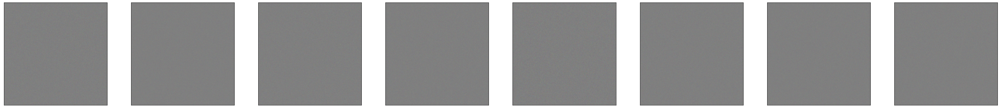

tf.Tensor(
[[ 0.01199699]
 [-0.04556815]
 [-0.09394945]
 [ 0.14063124]
 [ 0.08757753]
 [-0.28690225]
 [-0.05859209]
 [ 0.13460913]
 [ 0.03529105]
 [ 0.01095127]
 [ 0.050108  ]
 [-0.03529505]
 [ 0.16387498]
 [-0.18155648]
 [ 0.16612321]
 [-0.3645822 ]], shape=(16, 1), dtype=float32)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[Step 100] D Loss: 0.0801; G Loss: 16.7681


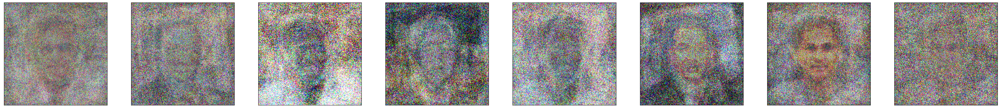

tf.Tensor(
[[-49.298954  ]
 [-39.278988  ]
 [  1.3689859 ]
 [-19.164684  ]
 [-55.974567  ]
 [ -0.17807189]
 [ -4.034048  ]
 [ -4.2219787 ]
 [ -8.939452  ]
 [  2.6758811 ]
 [ -6.9360595 ]
 [-11.806614  ]
 [-18.94219   ]
 [-32.234123  ]
 [ -6.725374  ]
 [ -9.618294  ]], shape=(16, 1), dtype=float32)


In [ ]:
for step, true_images in enumerate(train_ds):
    
    # Train Discriminator
    
    noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    syntetic_images = generator.predict(noise)
    x_combined = np.concatenate((
        true_images, 
        syntetic_images))
    y_combined = np.concatenate((
        np.ones((HALF_BATCH_SIZE, 1)), 
        np.zeros((HALF_BATCH_SIZE, 1))))
    with tf.GradientTape() as tape:
        logits = discriminator(x_combined)
        d_loss_value = tf.compat.v1.losses.sigmoid_cross_entropy(y_combined, logits)
    grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
    optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
    
    # Train Generator
    
    noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    y_mislabled = np.ones((BATCH_SIZE, 1))
    
    with tf.GradientTape() as tape:
        logits = discriminator(generator(noise, training=True))
        g_loss_value = tf.compat.v1.losses.sigmoid_cross_entropy(y_mislabled, logits)
    grads = tape.gradient(g_loss_value, generator.trainable_variables)
    optimizer.apply_gradients(zip(grads, generator.trainable_variables))
    
    # Check intermediate results
    
    if step % 100 == 0:
        print("[Step %2d] D Loss: %.4f; G Loss: %.4f" % (
            step, d_loss_value.numpy(), g_loss_value.numpy()))
        noise = np.random.normal(0, 1, (8, INPUT_DIM)).astype(np.float32)
        syntetic_images = generator.predict(noise)
        plot_images(syntetic_images)

        print(logits)

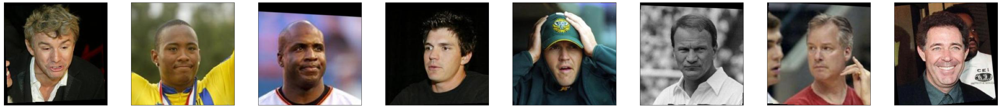

In [ ]:
def plot_images(images):
    fig = plt.figure(figsize=(50, 50))
    num = images.shape[0]
    for j in range(num):
        ax = fig.add_subplot(8, 8, j+1)
        ax.imshow(images[j, ...].reshape(250, 250,3)+0.5)
        plt.xticks([]), plt.yticks([])
    plt.show()
    
plot_images(train_x[:8, ...])

In [ ]:
generator = M.Sequential([
    L.Dense(512*16*16, activation="relu"),
    L.Reshape(( 16, 16,512)),


    L.Conv2DTranspose(256, (5, 5), strides = (2,2),padding="same"),#16x16x512
    L.BatchNormalization(momentum=0.8),
    L.ReLU(),
    #L.UpSampling2D((2, 2)),  

    L.Conv2DTranspose(128,(5, 5), strides = (2,2), padding="same"),#32x32x256
    L.BatchNormalization(momentum=0.8),
    L.ReLU(),
    #L.UpSampling2D((2, 2)),  #32

    #tf.keras.layers.Cropping2D(cropping=((0, 1), (0, 1))),#31

    L.Conv2DTranspose(64,(5, 5), strides = (2,2), padding="same"),#64x64x128
    L.BatchNormalization(momentum=0.8),
    L.ReLU(),    
   # L.UpSampling2D((2, 2)),  


    # L.Conv2DTranspose(64,(5, 5), strides = (2,2), padding="same"),#128x128x64
    # L.BatchNormalization(momentum=0.8),
    # L.ReLU(),  
   
    L.UpSampling2D((2, 2)),
     
    tf.keras.layers.Cropping2D(cropping=((3, 3), (3, 3))),

    L.Conv2DTranspose(3, (5, 5), padding="same", activation='tanh'),
])

discriminator = M.Sequential([
    L.Conv2D(64, (5, 5), strides=(2, 2), padding="same"),
    L.LeakyReLU(0.2),
    L.Dropout(0.25),    
    L.Conv2D(128, kernel_size=5, strides=(2, 2), padding="same"),
    L.BatchNormalization(momentum=0.8),
    L.LeakyReLU(alpha=0.2),
    L.Dropout(0.25),
    L.Conv2D(256, kernel_size=3, strides=(2, 2), padding="same"),
    L.BatchNormalization(momentum=0.8),
    L.LeakyReLU(alpha=0.2),
    L.Dropout(0.25),
    L.Conv2D(512, kernel_size=3, strides=(1, 1), padding="same"),
    L.BatchNormalization(momentum=0.8),
    L.LeakyReLU(alpha=0.2),
    L.Dropout(0.25),

    # L.Conv2D(1024, kernel_size=3, strides=(1, 1), padding="same"),
    # L.BatchNormalization(momentum=0.8),
    # L.LeakyReLU(alpha=0.2),
    # L.Dropout(0.25),

    L.Flatten(),
    
    
    L.Dense(1, activation=None),
])

In [ ]:
INPUT_DIM = 10
NUM_EPOCHS = 20
HALF_BATCH_SIZE = 8
BATCH_SIZE = HALF_BATCH_SIZE * 2
LEARNING_RATE = 0.00005

train_ds = tf.data.Dataset.from_tensor_slices(train_x.reshape(-1, 250, 250, 3))
train_ds = train_ds.shuffle(buffer_size=train_x.shape[0])
train_ds = train_ds.repeat(NUM_EPOCHS)
train_ds = train_ds.batch(HALF_BATCH_SIZE, drop_remainder=True)

optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)

[Step  0] D Loss: 0.4542; G Loss: 13.3625


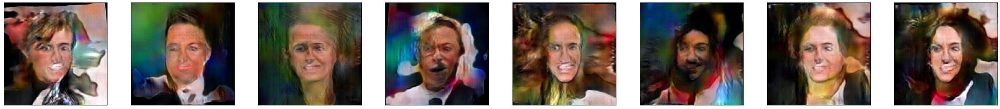

tf.Tensor(
[[-22.809767 ]
 [-13.938537 ]
 [-12.441369 ]
 [-14.790254 ]
 [ -4.9675198]
 [-15.39097  ]
 [ -8.524273 ]
 [-15.60598  ]
 [-16.81622  ]
 [-13.132153 ]
 [-13.462082 ]
 [ -9.332274 ]
 [-10.6910515]
 [-17.122448 ]
 [ -6.2863197]
 [-18.479374 ]], shape=(16, 1), dtype=float32)


[Step 200] D Loss: 0.2342; G Loss: 4.9795


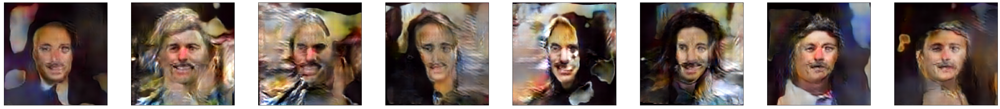

tf.Tensor(
[[ -4.5661683]
 [ -2.4103897]
 [ -4.701906 ]
 [  6.228052 ]
 [ -7.5708523]
 [ -1.8447701]
 [-14.259606 ]
 [ -1.9864515]
 [ -3.7513442]
 [ -1.7087923]
 [ -4.74846  ]
 [ -7.926475 ]
 [ -3.4840493]
 [ -9.930439 ]
 [-10.0735855]
 [  2.2852983]], shape=(16, 1), dtype=float32)


[Step 400] D Loss: 0.1193; G Loss: 8.0808


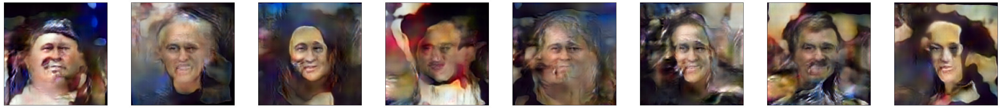

tf.Tensor(
[[ -4.476037 ]
 [ -5.102462 ]
 [ -5.9054294]
 [ -1.9066608]
 [ -7.2312655]
 [-14.342639 ]
 [ -9.619042 ]
 [-14.8223915]
 [-10.10519  ]
 [-13.07486  ]
 [-11.6867285]
 [ -5.556448 ]
 [ -7.333844 ]
 [ -4.884038 ]
 [ -1.6915044]
 [-11.213513 ]], shape=(16, 1), dtype=float32)


[Step 600] D Loss: 0.1066; G Loss: 4.6374


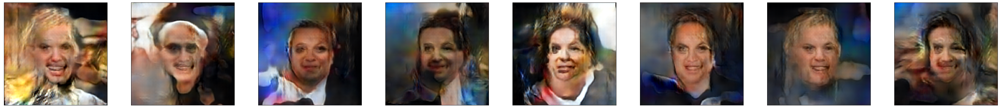

tf.Tensor(
[[-5.6864448]
 [-2.2026806]
 [-2.1888804]
 [-5.97346  ]
 [-6.59497  ]
 [-4.7065587]
 [-9.619986 ]
 [-1.9215621]
 [-1.8976998]
 [-5.3094087]
 [-5.8420334]
 [-1.6442645]
 [-3.7164035]
 [-5.008106 ]
 [-5.6170382]
 [-5.542768 ]], shape=(16, 1), dtype=float32)


[Step 800] D Loss: 0.0360; G Loss: 9.0961


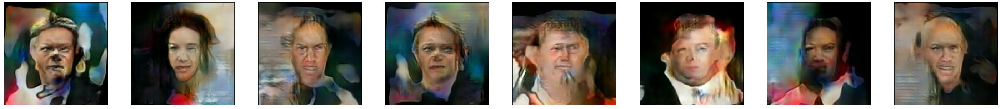

tf.Tensor(
[[-16.608479 ]
 [ -8.6692295]
 [ -4.311496 ]
 [ -4.9270697]
 [-13.459494 ]
 [ -5.35721  ]
 [ -7.2479825]
 [-11.597832 ]
 [ -9.207731 ]
 [ -2.365636 ]
 [ -9.862815 ]
 [-12.003776 ]
 [-10.9692545]
 [ -7.042527 ]
 [-10.496754 ]
 [-11.293848 ]], shape=(16, 1), dtype=float32)


[Step 1000] D Loss: 0.7217; G Loss: 9.7086


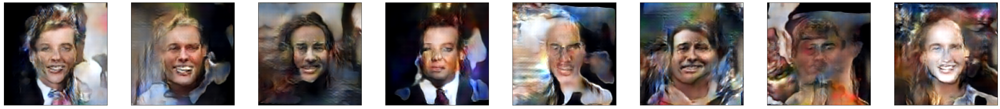

tf.Tensor(
[[ -2.4595463]
 [-11.109873 ]
 [ -6.0622106]
 [-12.087473 ]
 [ -5.8096395]
 [-15.6172285]
 [-10.971209 ]
 [-11.5768   ]
 [-12.659945 ]
 [-12.096777 ]
 [ -5.9527   ]
 [ -8.328341 ]
 [ -7.561691 ]
 [-24.656464 ]
 [ -4.1311145]
 [ -4.1347036]], shape=(16, 1), dtype=float32)


[Step 1200] D Loss: 1.1179; G Loss: 6.2564


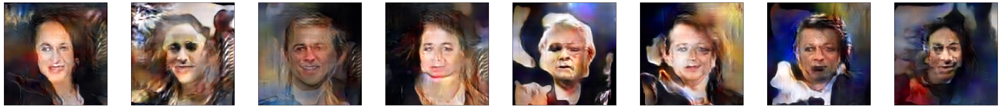

tf.Tensor(
[[ -4.227779  ]
 [ -1.1195284 ]
 [  0.8399082 ]
 [ -2.3343046 ]
 [ -0.3328938 ]
 [-25.812578  ]
 [ -8.219354  ]
 [ -7.620655  ]
 [ -4.1346383 ]
 [ -8.334214  ]
 [  0.47461206]
 [ -2.1136415 ]
 [ -4.7985287 ]
 [-15.824096  ]
 [ -9.239963  ]
 [ -4.0620937 ]], shape=(16, 1), dtype=float32)


[Step 1400] D Loss: 0.0431; G Loss: 6.4641


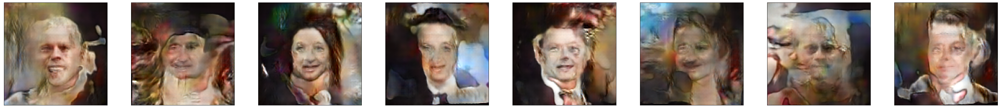

tf.Tensor(
[[ -8.113301 ]
 [ -8.564505 ]
 [ -8.910408 ]
 [-15.05627  ]
 [ -7.4823065]
 [ -5.4102   ]
 [ -6.4297843]
 [ -9.34557  ]
 [ -7.402349 ]
 [ -3.6787975]
 [  2.044322 ]
 [ -5.720044 ]
 [ -5.1845884]
 [ -1.6266401]
 [ -5.732418 ]
 [ -4.410243 ]], shape=(16, 1), dtype=float32)


[Step 1600] D Loss: 0.0118; G Loss: 7.3224


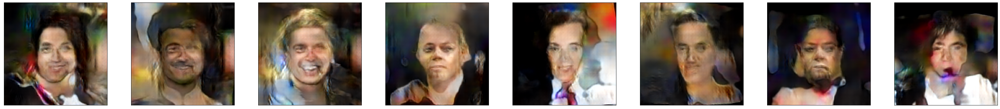

tf.Tensor(
[[ -6.8579926 ]
 [ -4.90038   ]
 [ -8.759619  ]
 [ -7.59425   ]
 [ -7.889696  ]
 [ -3.029376  ]
 [ -9.161634  ]
 [ -4.7508097 ]
 [ -0.62252337]
 [ -5.7036333 ]
 [ -8.784624  ]
 [ -5.301031  ]
 [-11.242225  ]
 [ -6.552276  ]
 [-12.561981  ]
 [-12.942003  ]], shape=(16, 1), dtype=float32)


[Step 1800] D Loss: 0.3188; G Loss: 8.3482


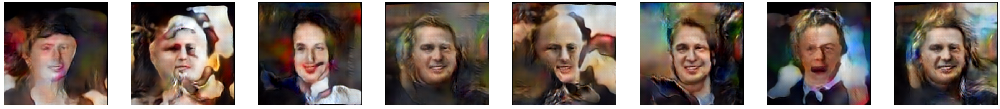

tf.Tensor(
[[-11.150555 ]
 [ -4.790722 ]
 [ -7.1509833]
 [ -9.317773 ]
 [ -5.145272 ]
 [ -8.293992 ]
 [-10.572343 ]
 [-11.222299 ]
 [ -8.746758 ]
 [-10.06425  ]
 [ -6.4543467]
 [ -7.16344  ]
 [ -6.9500403]
 [ -8.471044 ]
 [-11.151788 ]
 [ -6.905125 ]], shape=(16, 1), dtype=float32)


[Step 2000] D Loss: 0.5573; G Loss: 6.4491


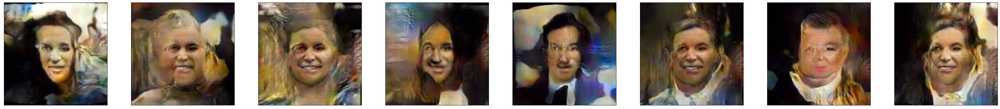

tf.Tensor(
[[ -3.583038  ]
 [ -7.2164235 ]
 [-10.689285  ]
 [ -5.3484826 ]
 [ -4.144071  ]
 [ -5.4079146 ]
 [ -9.538269  ]
 [ -5.630944  ]
 [ -0.90064454]
 [ -6.000072  ]
 [-10.676097  ]
 [ -6.1738687 ]
 [ -6.739103  ]
 [ -6.721894  ]
 [ -5.991653  ]
 [ -8.015897  ]], shape=(16, 1), dtype=float32)


[Step 2200] D Loss: 0.1583; G Loss: 7.1431


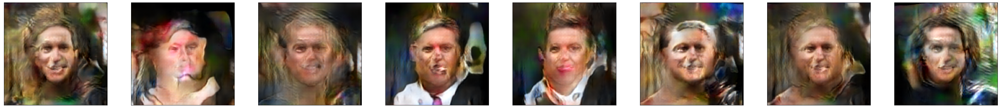

tf.Tensor(
[[ -6.44915  ]
 [ -8.020191 ]
 [ -2.5844295]
 [-16.804508 ]
 [ -4.192145 ]
 [ -1.0516367]
 [ -9.6823   ]
 [ -5.2542214]
 [-13.406611 ]
 [ -8.087595 ]
 [ -5.4861007]
 [  2.3689926]
 [  4.4786477]
 [ -8.682415 ]
 [-14.894004 ]
 [ -9.194738 ]], shape=(16, 1), dtype=float32)


[Step 2400] D Loss: 1.7404; G Loss: 9.3271


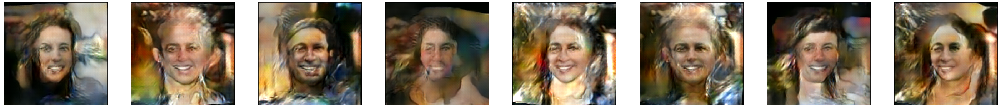

tf.Tensor(
[[-10.941871 ]
 [ -9.757886 ]
 [-10.083987 ]
 [ -7.4957466]
 [ -8.579533 ]
 [ -7.9988956]
 [ -9.300809 ]
 [ -8.692658 ]
 [ -6.4264235]
 [ -9.044872 ]
 [-14.741419 ]
 [ -8.530925 ]
 [ -8.261322 ]
 [-10.091554 ]
 [ -9.984616 ]
 [ -9.296709 ]], shape=(16, 1), dtype=float32)


[Step 2600] D Loss: 0.4123; G Loss: 3.6399


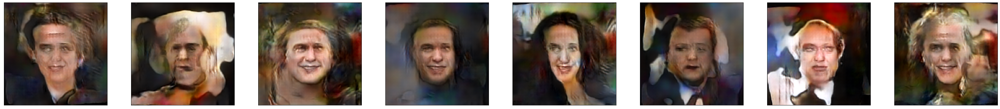

tf.Tensor(
[[-4.325297  ]
 [-2.5308962 ]
 [-3.2391186 ]
 [-5.0600166 ]
 [-0.41095424]
 [-2.8691049 ]
 [-4.002284  ]
 [-3.7668006 ]
 [-4.2098227 ]
 [-2.1321266 ]
 [-4.5366673 ]
 [-1.0880616 ]
 [-5.3013973 ]
 [-4.353204  ]
 [-4.321978  ]
 [-4.884678  ]], shape=(16, 1), dtype=float32)


[Step 2800] D Loss: 0.8636; G Loss: 7.3093


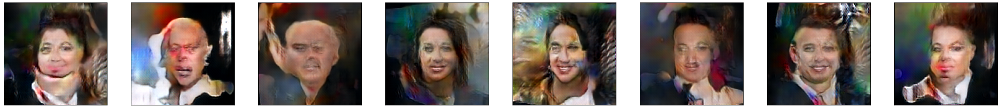

tf.Tensor(
[[ -2.0402215]
 [ -7.742452 ]
 [ -8.848937 ]
 [ -7.1889772]
 [ -5.782276 ]
 [ -6.9964657]
 [ -9.578173 ]
 [ -9.091058 ]
 [ -9.991187 ]
 [-13.852026 ]
 [ -5.2657337]
 [ -3.394086 ]
 [ -4.418558 ]
 [ -6.479024 ]
 [ -5.5075145]
 [-10.588242 ]], shape=(16, 1), dtype=float32)


[Step 3000] D Loss: 0.9979; G Loss: 6.7486


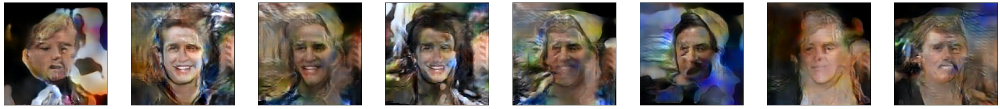

tf.Tensor(
[[-10.313196 ]
 [ -6.4647145]
 [ -7.2176933]
 [ -6.776122 ]
 [  0.5427132]
 [-10.659463 ]
 [ -8.290526 ]
 [ -9.098928 ]
 [ -6.7223287]
 [ -4.892905 ]
 [ -4.525116 ]
 [ -3.9898045]
 [ -9.284143 ]
 [ -8.335411 ]
 [ -2.9951396]
 [ -7.8627763]], shape=(16, 1), dtype=float32)


[Step 3200] D Loss: 0.1086; G Loss: 6.1439


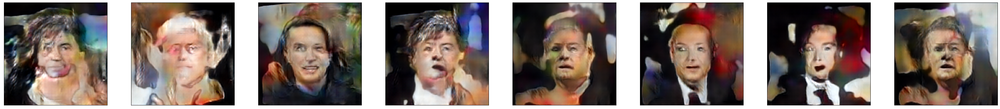

tf.Tensor(
[[ -1.2964104]
 [ -6.141798 ]
 [ -5.76092  ]
 [ -5.9784746]
 [ -8.160187 ]
 [ -9.123409 ]
 [ -4.750413 ]
 [ -9.395975 ]
 [ -1.945396 ]
 [ -4.529428 ]
 [-11.440079 ]
 [ -8.549028 ]
 [ -3.843669 ]
 [ -6.275644 ]
 [ -4.8964453]
 [ -5.778165 ]], shape=(16, 1), dtype=float32)


[Step 3400] D Loss: 0.1597; G Loss: 7.8182


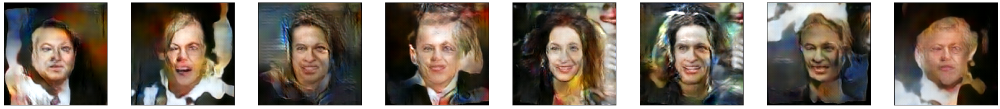

tf.Tensor(
[[ -8.136589 ]
 [ -3.8773987]
 [ -7.663662 ]
 [ -7.3966026]
 [-12.312192 ]
 [-12.017657 ]
 [ -2.998049 ]
 [ 10.319521 ]
 [-10.321589 ]
 [-10.22081  ]
 [-11.66513  ]
 [ -9.042336 ]
 [ -3.3859153]
 [ -4.421178 ]
 [-12.634156 ]
 [ -8.882123 ]], shape=(16, 1), dtype=float32)


In [ ]:
for step, true_images in enumerate(train_ds):
    
    # Train Discriminator
    
    noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    syntetic_images = generator.predict(noise)
    x_combined = np.concatenate((
        true_images, 
        syntetic_images))
    y_combined = np.concatenate((
        np.ones((HALF_BATCH_SIZE, 1)), 
        np.zeros((HALF_BATCH_SIZE, 1))))
    
    with tf.GradientTape() as tape:
        logits = discriminator(x_combined, training=True)
        d_loss_value = tf.compat.v1.losses.sigmoid_cross_entropy(y_combined, logits)
    grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
    optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
    
    # Train Generator
    
    noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    y_mislabled = np.ones((BATCH_SIZE, 1))
    
    with tf.GradientTape() as tape:
        syntetic = generator(noise, training=True)
        logits = discriminator(syntetic, training=False)
        g_loss_value = tf.compat.v1.losses.sigmoid_cross_entropy(y_mislabled, logits)
    grads = tape.gradient(g_loss_value, generator.trainable_variables)
    optimizer.apply_gradients(zip(grads, generator.trainable_variables))
    
    # Check intermediate results
    
    if step % 200 == 0:
        print("[Step %2d] D Loss: %.4f; G Loss: %.4f" % (
            step, d_loss_value.numpy(), g_loss_value.numpy()))
        noise = np.random.normal(0, 1, (8, INPUT_DIM)).astype(np.float32)
        syntetic_images = generator.predict(noise)
        plot_images(syntetic_images)

        print(logits)

In [ ]:
generator.save('/content/drive/MyDrive/generator')
discriminator.save('/content/drive/MyDrive/discriminator')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/generator/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/generator/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/discriminator/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/discriminator/assets


In [ ]:
generator= tf.keras.models.load_model('/content/drive/MyDrive/generator')
discriminator= tf.keras.models.load_model('/content/drive/MyDrive/discriminator')

In [ ]:
noise_1= np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise_2= np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise_3= np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise_4= np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
N=24
noise = np.vstack((np.linspace(noise_1, noise_2, N)[1:],np.linspace(noise_2, noise_3, N)[1:],np.linspace(noise_3, noise_4, N)[1:],np.linspace(noise_4, noise_1, N)[1:]))
syntetic_images = generator.predict(noise)
print(len(noise))

92


In [ ]:
import imageio
images = []
for i in range(len(noise)):
    images.append(syntetic_images[i])

imageio.mimsave('/content/drive/MyDrive/movie22.gif', images)